In [324]:
import os
from glob import glob
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

%matplotlib inline
plt.rcParams["figure.figsize"] = (20, 10)

In [325]:
from pkg.kitti_utils import *
from ultralytics import YOLO

In [326]:
DATA_PATH = r'./dataset/2011_10_03_drive_0047_sync'

# get RGB camera data
left_image_paths = sorted(glob(os.path.join(DATA_PATH, 'image_02/data/*.png')))
right_image_paths = sorted(glob(os.path.join(DATA_PATH, 'image_03/data/*.png')))

# get LiDAR data
bin_paths = sorted(glob(os.path.join(DATA_PATH, 'velodyne_points/data/*.bin')))

# get GPS/IMU data
oxts_paths = sorted(glob(os.path.join(DATA_PATH, r'oxts/data**/*.txt')))

print(f"Number of left images: {len(left_image_paths)}")
print(f"Number of right images: {len(right_image_paths)}")
print(f"Number of LiDAR point clouds: {len(bin_paths)}")
print(f"Number of GPS/IMU frames: {len(oxts_paths)}")

Number of left images: 10
Number of right images: 0
Number of LiDAR point clouds: 10
Number of GPS/IMU frames: 10


In [327]:
with open('./dataset/2011_10_03_calib/calib_cam_to_cam.txt','r') as f_cam:
    calib_cam2cam =f_cam.readlines()

# get projection matrices (rectified left camera --> left camera (u,v,z))
P_rect2_cam2 = np.array([float(x) for x in calib_cam2cam[25].strip().split(' ')[1:]]).reshape((3,4))


# get rectified rotation matrices (left camera --> rectified left camera)
R_ref0_rect2 = np.array([float(x) for x in calib_cam2cam[24].strip().split(' ')[1:]]).reshape((3, 3,))

# add (0,0,0) translation and convert to homogeneous coordinates
R_ref0_rect2 = np.insert(R_ref0_rect2, 3, values=[0,0,0], axis=0)
R_ref0_rect2 = np.insert(R_ref0_rect2, 3, values=[0,0,0,1], axis=1)


# get rigid transformation from Camera 0 (ref) to Camera 2
R_2 = np.array([float(x) for x in calib_cam2cam[21].strip().split(' ')[1:]]).reshape((3,3))
t_2 = np.array([float(x) for x in calib_cam2cam[22].strip().split(' ')[1:]]).reshape((3,1))

# get cam0 to cam2 rigid body transformation in homogeneous coordinates
T_ref0_ref2 = np.insert(np.hstack((R_2, t_2)), 3, values=[0,0,0,1], axis=0)

## **Load LiDAR and GPS/IMU Calibration Data**

In [328]:
T_velo_ref0 = get_rigid_transformation(r'./dataset/2011_10_03_calib/calib_velo_to_cam.txt')
T_imu_velo = get_rigid_transformation(r'./dataset/2011_10_03_calib/calib_imu_to_velo.txt')

In [329]:
# transform from velo (LiDAR) to left color camera (shape 3x4)
T_velo_cam2 = P_rect2_cam2 @ R_ref0_rect2 @ T_ref0_ref2 @ T_velo_ref0 

# homogeneous transform from left color camera to velo (LiDAR) (shape: 4x4)
T_cam2_velo = np.linalg.inv(np.insert(T_velo_cam2, 3, values=[0,0,0,1], axis=0)) 

In [330]:
# transform from IMU to left color camera (shape 3x4)
T_imu_cam2 = T_velo_cam2 @ T_imu_velo

# homogeneous transform from left color camera to IMU (shape: 4x4)
T_cam2_imu = np.linalg.inv(np.insert(T_imu_cam2, 3, values=[0,0,0,1], axis=0)) 

In [331]:
model = YOLO("yolov8n.pt")
model.conf = 0.8  # confidence threshold
model.iou = 0.5 # NMS IoU threshold
model.classes = [0, 1, 2, 3, 5, 7]  # only person, bicycle, car, motorcycle, bus, truck

In [332]:
def get_uvz_centers(image, velo_uvz, bboxes, draw=True):
    ''' Inputs:
          image  
          velo_uvz 
          bboxes 
          draw 
        Outputs:
          bboxes_out
        '''

    # unpack LiDAR camera coordinates
    u, v, z = velo_uvz

    # get new output
    bboxes_out = np.zeros((bboxes.shape[0], bboxes.shape[1] + 3))
    bboxes_out[:, :bboxes.shape[1]] = bboxes

    # iterate through all detected bounding boxes
    for i, bbox in enumerate(bboxes):
        pt1 = np.round(bbox[0:2]).astype(int)
        pt2 = np.round(bbox[2:4]).astype(int)

        # get center location of the object on the image
        obj_x_center = (pt1[1] + pt2[1]) / 2
        obj_y_center = (pt1[0] + pt2[0]) / 2

        # now get the closest LiDAR points to the center
        center_delta = np.abs(np.array((v, u)) 
                              - np.array([[obj_x_center, obj_y_center]]).T)
        
        # choose coordinate pair with the smallest L2 norm
        min_loc = np.argmin(np.linalg.norm(center_delta, axis=0))

        # get LiDAR location in image/camera space
        velo_depth = z[min_loc]; # LiDAR depth in camera space
        uvz_location = np.array([u[min_loc], v[min_loc], velo_depth])
        
        # add velo projections (u, v, z) to bboxes_out
        bboxes_out[i, -3:] = uvz_location

        # draw depth on image at center of each bounding box
        # This is depth as perceived by the camera
        if draw:
            object_center = (np.round(obj_y_center).astype(int), 
                             np.round(obj_x_center).astype(int))
            cv2.putText(image, 
                        '{0:.2f} m'.format(velo_depth), 
                        object_center, # top left
                        cv2.FONT_HERSHEY_SIMPLEX, 
                        0.5, # font scale
                        (255, 0, 0), 2, cv2.LINE_AA)    
            
    return bboxes_out


In [333]:
def get_detection_coordinates(image, bin_path, draw_boxes=True):
    """
    Obtains detections for the input image, along with the coordinates of 
    the detected object centers in:
    - Camera with depth (uvz)
    - LiDAR/velo (xyz)
    - GPS/IMU  (xyz)
    """
    # Perform detection
    detections = model(image)
    
    # Filter detections based on confidence and class indices
    desired_classes = [0, 1, 2, 3, 5, 7]  # Only person, bicycle, car, motorcycle, bus, truck
    confidence_threshold = 0.5
    filtered_boxes = []
    for box in detections[0].boxes.data.cpu().numpy():  # [x1, y1, x2, y2, confidence, class]
        confidence, cls = box[4], int(box[5])
        if confidence >= confidence_threshold and cls in desired_classes:
            filtered_boxes.append(box)
    
    filtered_boxes = np.array(filtered_boxes)
    
    # Draw boxes on the image
    if draw_boxes:
        if len(filtered_boxes) > 0:
            for box in filtered_boxes:
                x1, y1, x2, y2, conf, cls = box
                label = f"{model.names[int(cls)]} {conf:.2f}"
                # Draw rectangle and label on the image
                image = cv2.rectangle(image, (int(x1), int(y1)), (int(x2), int(y2)), (0, 255, 0), 1)
                image = cv2.putText(image, label, (int(x1), int(y1)-10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)
            
            
            image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  
            plt.imshow(cv2.cvtColor(image_rgb, cv2.COLOR_BGR2RGB))
            plt.axis('off')
            plt.show()
        else:
            print("No detections met the criteria.")
    
    # Project LiDAR points to camera space
    velo_uvz = project_velobin2uvz(bin_path, T_velo_cam2, image, remove_plane=False)

    # Map bounding boxes to uvz centers
    if len(filtered_boxes) > 0:
        bboxes = get_uvz_centers(image, velo_uvz, filtered_boxes)
    else:
        bboxes = []

    return bboxes, velo_uvz


In [334]:
import pymap3d as pm


def imu2geodetic(x, y, z, lat0, lon0, alt0, heading0):
    ''' Converts cartesian IMU coordinates to Geodetic based on current 
        location. This function works with x,y,z as vectors and lat0, lon0, 
        alt0 as scalars.

        - Correct orientation is provided by the heading
        - The Elevation must be corrected for pymap3d (i.e. 180 is 0 elevation)
        Inputs:
            x - IMU x-coodinate (either scaler of (Nx1) array)
            y - IMU y-coodinate (either scaler of (Nx1) array)
            z - IMU z-coodinate (either scaler of (Nx1) array)
            lat0 - initial Latitude in degrees
            lon0 - initial Longitude in degrees
            alt0 - initial Ellipsoidal Altitude in meters
            heading0 - initial heading in radians (0 - East, positive CCW)
        Outputs:
            lla - (Nx3) numpy array of 
        '''
    # convert to RAE
    rng = np.sqrt(x**2 + y**2 + z**2)
    az = np.degrees(np.arctan2(y, x)) + np.degrees(heading0)
    el = np.degrees(np.arctan2(np.sqrt(x**2 + y**2), z)) + 90 
    
    # convert to geodetic
    lla = pm.aer2geodetic(az, el, rng, lat0, lon0, alt0)

    # convert to numpy array
    lla = np.vstack((lla[0], lla[1], lla[2])).T

    return lla

## **Test the pipeline**


0: 224x640 6 cars, 23.3ms
Speed: 1.8ms preprocess, 23.3ms inference, 0.5ms postprocess per image at shape (1, 3, 224, 640)


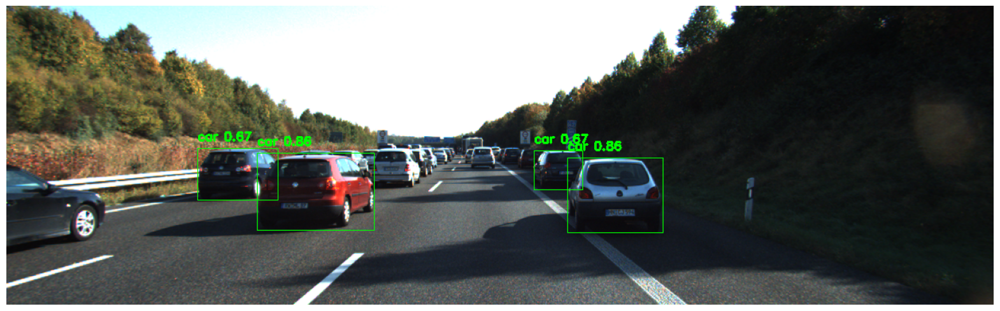

In [335]:
index = 9

left_image = cv2.cvtColor(cv2.imread(left_image_paths[index]), cv2.COLOR_BGR2RGB)
left_image_copy= left_image.copy()
bin_path = bin_paths[index]
oxts_frame = get_oxts(oxts_paths[index])

# get detections and object centers in uvz
bboxes, velo_uvz = get_detection_coordinates(left_image, bin_path,draw_boxes=True)

# get transformed coordinates of object centers
uvz = bboxes[:, -3:]

In [278]:
# transform to (u,v,z)
# velo_xyz = transform_uvz(uvz, T_cam2_velo) # we can also get LiDAR coordiantes
imu_xyz = transform_uvz(uvz, T_cam2_imu)

# get Lat/Lon on each detected object
lat0 = oxts_frame[0]
lon0 = oxts_frame[1]
alt0 = oxts_frame[2]
heading0 = oxts_frame[5]

lla = imu2geodetic(imu_xyz[:, 0], imu_xyz[:, 1], imu_xyz[:, 2], lat0, lon0, alt0, heading0)
# lla = imu2geodetic(velo_xyz[:, 0], velo_xyz[:, 1], velo_xyz[:, 2], lat0, lon0, alt0, heading0)

In [279]:
velo_image = draw_velo_on_image(velo_uvz, np.zeros_like(left_image))

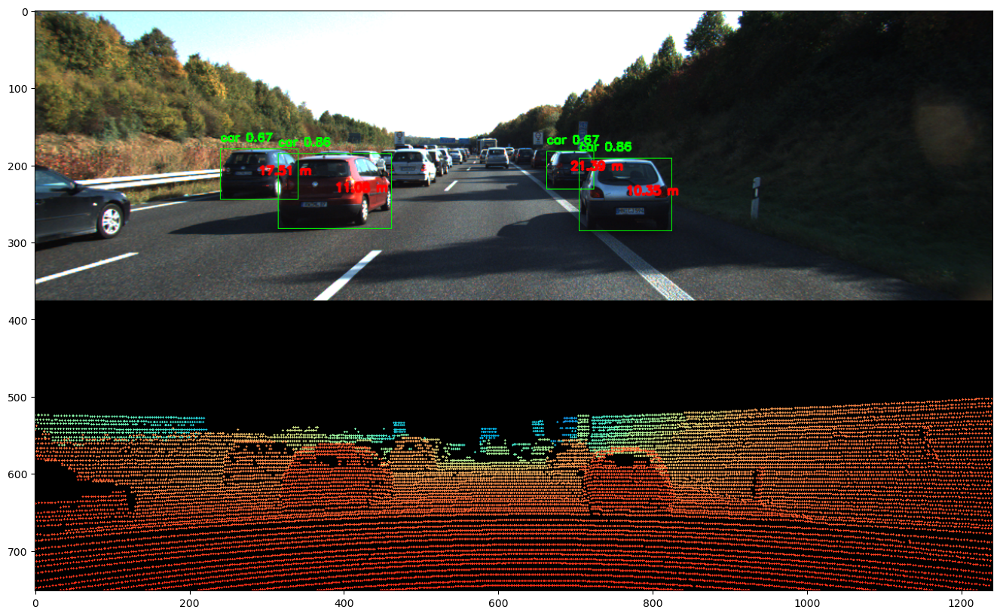

In [280]:
# pymap3d seems to mess with matplotlib in colab
%matplotlib inline
plt.rcParams["figure.figsize"] = (20, 10)

# stack image with LiDAR point cloud
stacked = np.vstack((left_image, velo_image))

# display stacked iamge
plt.imshow(stacked)
plt.savefig("./output/image_with_depth.png")

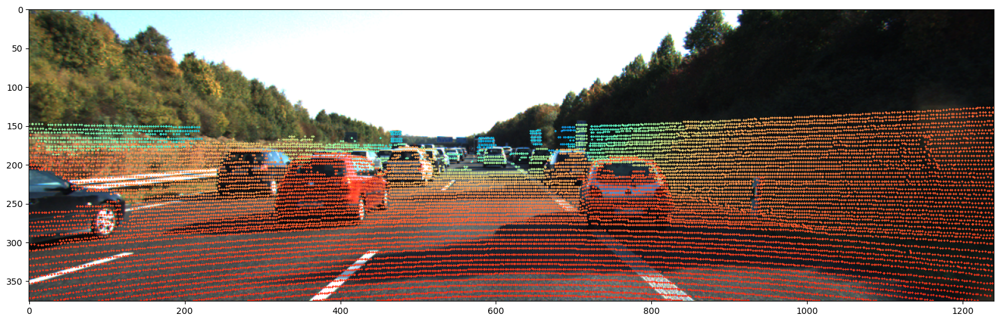

In [281]:
left_image_2 = cv2.cvtColor(cv2.imread(left_image_paths[index]), cv2.COLOR_BGR2RGB)
velo_image_2 = draw_velo_on_image(velo_uvz, left_image_2)

plt.imshow(velo_image_2)
plt.savefig('./output/lid_proj.png')

In [282]:
import folium

drive_map = folium.Map(
    location=(lat0, lon0), # starting location
    zoom_start=18
)

# add Lat/Lon points to map
folium.CircleMarker(location=(lat0, lon0),
                    radius=2,
                    weight=5,
                    color='red').add_to(drive_map);

In [283]:
# place the position of each detection on the map
for pos in lla:
    folium.CircleMarker(location=(pos[0], pos[1]),
                        radius=2,
                        weight=5,
                        color='green').add_to(drive_map);
    print(pos)

# add Lat/Lon points to map
folium.CircleMarker(location=(lat0, lon0),
                    radius=2,
                    weight=5,
                    color='red').add_to(drive_map);
drive_map.save('./output/drive_map.html')

[      48.95      8.4874      269.91]
[      48.95      8.4874      269.95]
[      48.95      8.4874      269.95]
[      48.95      8.4876      269.97]


In [284]:
drive_map


In [285]:
canvas_height = stacked.shape[0]
canvas_width = 500

# get consistent center for ego vehicle
ego_center = (250, int(canvas_height*0.95))

# get rectangle coordiantes for ego vehicle
ego_x1 = ego_center[0] - 5
ego_y1 = ego_center[1] - 10
ego_x2 = ego_center[0] + 5
ego_y2 = ego_center[1] + 10

In [286]:
def draw_scenario(canvas, imu_xyz, sf=12):
    # draw ego vehicle
    cv2.rectangle(canvas, (ego_x1, ego_y1), (ego_x2, ego_y2), (0, 255, 0), -1);

    # draw detected objects
    for val in imu_xyz:
        obj_center = (ego_center[0] - sf*int(np.round(val[1])),
                      ego_center[1] - sf*int(np.round(val[0])))
        # cv2.circle(canvas, obj_center, 5, (255, 0, 0), -1);

        # get object rectangle coordinates
        obj_x1 = obj_center[0] - 5
        obj_y1 = obj_center[1] - 10
        obj_x2 = obj_center[0] + 5
        obj_y2 = obj_center[1] + 10

        cv2.rectangle(canvas, (obj_x1, obj_y1), (obj_x2, obj_y2), (255, 0, 0), -1);

    return canvas

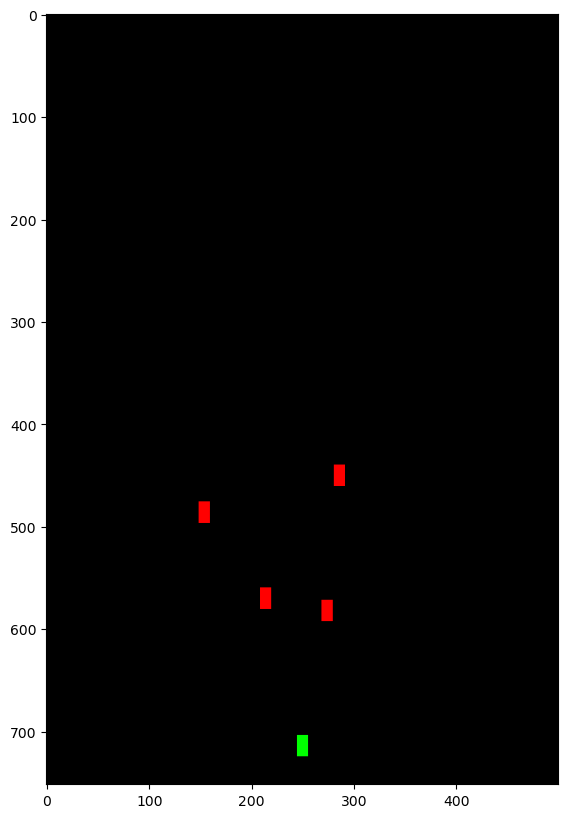

In [287]:
canvas = np.zeros((canvas_height, canvas_width, 3), dtype=np.uint8)
draw_scenario(canvas, imu_xyz, sf=12)
plt.imshow(canvas)
plt.savefig('./output/bev.png')

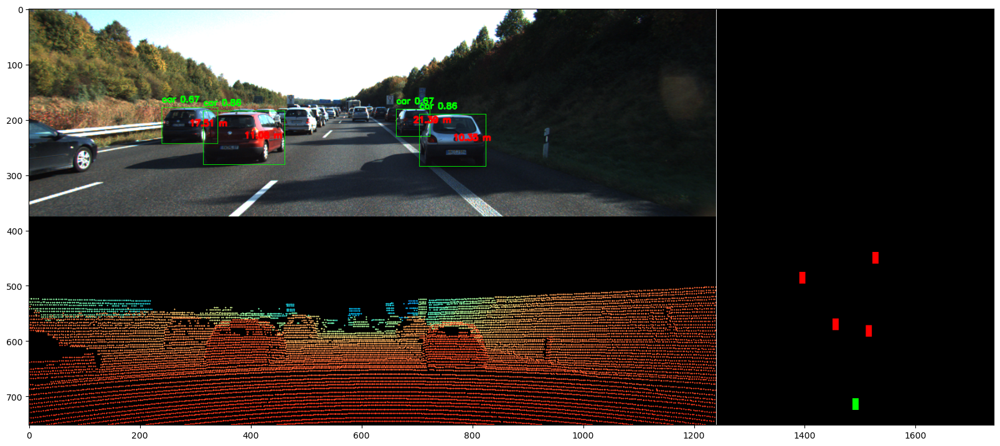

In [288]:
frame = np.hstack((stacked, 
                  255*np.ones((canvas_height, 1, 3), dtype=np.uint8),
                  canvas))

plt.imshow(frame)
plt.savefig('./output/comination.png')

In [289]:
imu_xyz,uvz

(array([[     12.159,      3.1679,    -0.16187],
        [     11.443,     -2.4626,    -0.11895],
        [     18.589,      7.5421,    -0.12273],
        [     22.484,     -2.7776,   -0.096627]]),
 array([[      389.1,      235.81,      11.076],
        [     764.76,      239.46,      10.354],
        [        290,      211.96,       17.51],
        [     694.49,      207.36,      21.393]]))

In [290]:
(uvz[:, 2] + 1.08) - imu_xyz[:, 0]

array([ -0.0028112,  -0.0095641,   0.0015089,   -0.010608])

In [291]:
with open('./dataset/2011_10_03_calib/calib_cam_to_cam.txt','r') as f:
    calib = f.readlines()

# get projection matrices
P_left = np.array([float(x) for x in calib[25].strip().split(' ')[1:]]).reshape((3,4))
P_right = np.array([float(x) for x in calib[33].strip().split(' ')[1:]]).reshape((3,4))

# get rectified rotation matrices
R_left_rect = np.array([float(x) for x in calib[24].strip().split(' ')[1:]]).reshape((3, 3,))
R_right_rect = np.array([float(x) for x in calib[32].strip().split(' ')[1:]]).reshape((3, 3,))

R_left_rect = np.insert(R_left_rect, 3, values=[0,0,0], axis=0)
R_left_rect = np.insert(R_left_rect, 3, values=[0,0,0,1], axis=1)

In [292]:
def decompose_projection_matrix(P):    
    K, R, T, _, _, _, _ = cv2.decomposeProjectionMatrix(P)
    T = T/T[3]

    return K, R, T

In [293]:
K_left, R_left, T_left = decompose_projection_matrix(P_left)
K_right, R_right, T_right = decompose_projection_matrix(P_right)

In [294]:
with open(r'./dataset/2011_10_03_calib/calib_velo_to_cam.txt', 'r') as f:
    calib = f.readlines()

R_cam_velo = np.array([float(x) for x in calib[1].strip().split(' ')[1:]]).reshape((3, 3))
t_cam_velo = np.array([float(x) for x in calib[2].strip().split(' ')[1:]])[:, None]

T_cam_velo = np.vstack((np.hstack((R_cam_velo, t_cam_velo)),
                        np.array([0, 0, 0, 1])))



In [295]:
# matrix to transform from velo (LiDAR) to left color camera
T_mat = P_left @ R_left_rect @ T_cam_velo

In [296]:
def velo2camera(velo_points, image=None, remove_outliers=True):
    ''' maps velo points (LiDAR) to camera (u,v,z) space '''
    # convert to (left) camera coordinates
    # P_left @ R_left_rect @ T_cam_velo
    velo_camera =  T_mat @ velo_points

    # delete negative camera points ??
    velo_camera  = np.delete(velo_camera , np.where(velo_camera [2,:] < 0)[0], axis=1) 

    # get camera coordinates u,v,z
    velo_camera[:2] /= velo_camera[2, :]

    # remove outliers (points outside of the image frame)
    if remove_outliers:
        u, v, z = velo_camera
        img_h, img_w, _ = image.shape
        u_out = np.logical_or(u < 0, u > img_w)
        v_out = np.logical_or(v < 0, v > img_h)
        outlier = np.logical_or(u_out, v_out)
        velo_camera = np.delete(velo_camera, np.where(outlier), axis=1)

    return velo_camera

In [297]:
from sklearn import linear_model

def bin2h_velo(lidar_bin, remove_plane=False):
    ''' Reads LiDAR bin file and returns homogeneous (x,y,z,1) LiDAR points'''
    # read in LiDAR data
    scan_data = np.fromfile(lidar_bin, dtype=np.float32).reshape((-1,4))

    # get x,y,z LiDAR points (x, y, z) --> (front, left, up)
    velo_points = scan_data[:, 0:3] 

    # delete negative liDAR points
    velo_points = np.delete(velo_points, np.where(velo_points[3, :] < 0), axis=1)

    # use ransac to remove ground plane
    if remove_plane:
            ransac = linear_model.RANSACRegressor(
                                          linear_model.LinearRegression(),
                                          residual_threshold=0.1,
                                          max_trials=5000
                                          )

            X = velo_points[:, :2]
            y = velo_points[:, -1]
            ransac.fit(X, y)


            # remove outlier points
            mask = ransac.inlier_mask_
            velo_points = velo_points[~mask]

    # homogeneous LiDAR points
    velo_points = np.insert(velo_points, 3, 1, axis=1).T 

    return velo_points

In [298]:
def project_velo2cam(lidar_bin, image, remove_plane=False):
    ''' Projects LiDAR point cloud onto the image coordinate frame '''

    # get homogeneous LiDAR points from binn file
    velo_points = bin2h_velo(lidar_bin, remove_plane)

    # get camera (u, v, z) coordinates
    velo_camera = velo2camera(velo_points, image, remove_outliers=True)
    
    return velo_camera

In [299]:
left_image = cv2.cvtColor(cv2.imread(left_image_paths[index]), cv2.COLOR_BGR2RGB)
lidar_bin = bin_paths[index]

(u, v, z) = project_velo2cam(lidar_bin, left_image)

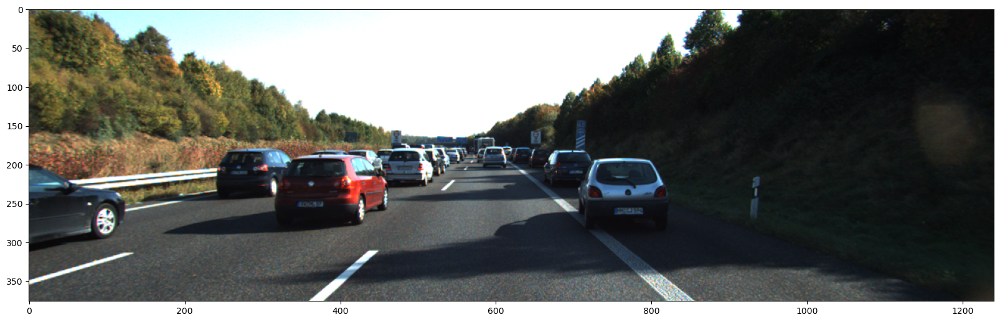

In [300]:
# plot points over iamge
plt.imshow(left_image)

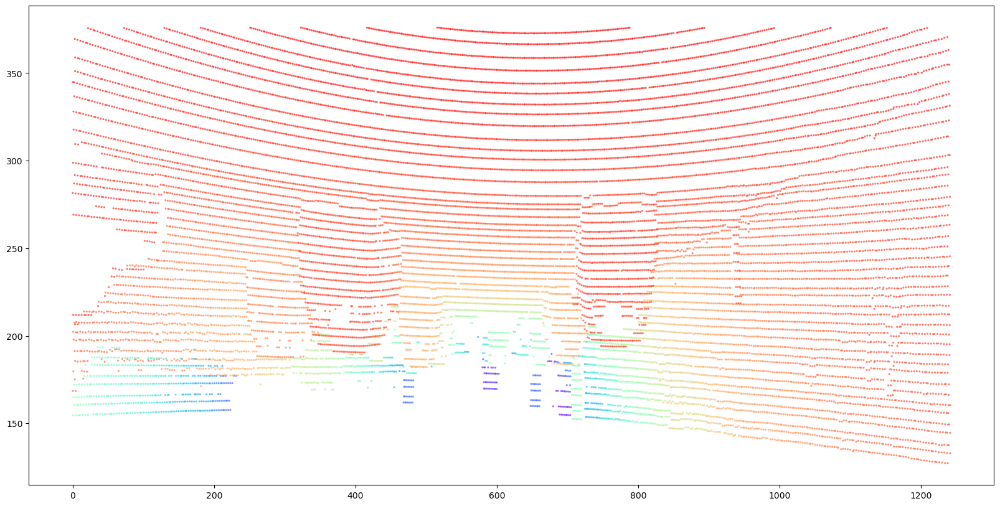

In [301]:
plt.scatter([u], [v], c=[z], cmap='rainbow_r', alpha=0.5, s=2);

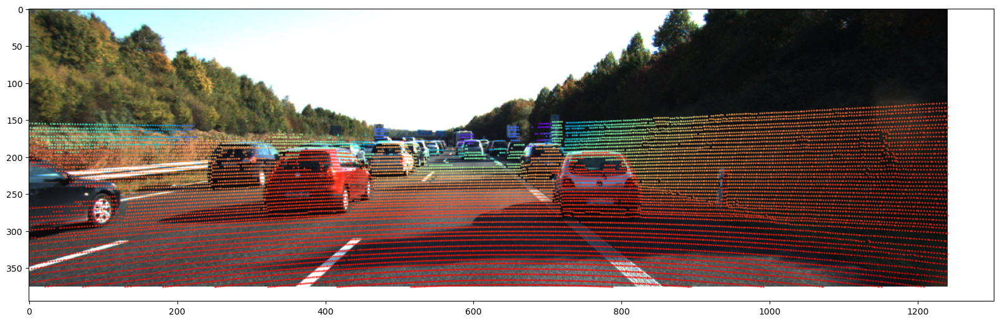

In [302]:
(u, v, z) = project_velo2cam(lidar_bin, left_image, remove_plane=False)

# plot points over iamge
plt.imshow(left_image)
plt.scatter([u], [v], c=[z], cmap='rainbow_r', alpha=0.5, s=2);

In [303]:
def get_distances(image, velo_camera, bboxes, draw=True):
    """
    Obtains distance measurements for each detected object in the image.
    
    Inputs:
        image - input image for detection 
        velo_camera - tuple of (u, v, z) from LiDAR camera coordinates
        bboxes - xyxy bounding boxes from detections (NumPy array)
        draw - whether to draw distances on the image (bool)
    
    Outputs:
        image - input image with distances drawn at the center of each bounding box
        bboxes_out - bounding boxes with additional LiDAR location data (u, v, z)
    """

    # Unpack LiDAR camera coordinates
    u, v, z = velo_camera

    # Prepare output bounding boxes
    bboxes_out = np.zeros((bboxes.shape[0], bboxes.shape[1] + 3))
    bboxes_out[:, :bboxes.shape[1]] = bboxes

    for i, bbox in enumerate(bboxes):
        # Get bounding box points as integers
        pt1 = np.round(bbox[0:2]).astype(int)  # Top-left corner
        pt2 = np.round(bbox[2:4]).astype(int)  # Bottom-right corner

        # Compute the center of the bounding box
        x_center = (pt1[0] + pt2[0]) // 2
        y_center = (pt1[1] + pt2[1]) // 2

        # Find the closest LiDAR points to the center
        center_delta = np.abs(np.array([v, u]) - np.array([[y_center, x_center]]).T)
        
        # Choose coordinate pair with the smallest L2 norm
        min_loc = np.argmin(np.linalg.norm(center_delta, axis=0))

        # Get LiDAR location in camera space
        velo_depth = z[min_loc]  # LiDAR depth in camera space
        velo_location = np.array([v[min_loc], u[min_loc], velo_depth])

        # Add LiDAR coordinates (u, v, z) to bounding boxes
        bboxes_out[i, -3:] = velo_location

        # Draw depth on image at the center of each bounding box
        if draw:
            object_center = (x_center, y_center)
            cv2.putText(
                image,
                '{0:.2f} m'.format(velo_depth),
                object_center,
                cv2.FONT_HERSHEY_SIMPLEX,
                0.5,
                (255, 0, 0),
                2,
                cv2.LINE_AA
            )

    return image, bboxes_out


In [304]:
def image_clusters_from_velo(velo_points, labels, image):
    ''' Obtains clusters in image space from velo (LiDAR) points 
        Inputs:
            velo_points (4xN) Homogeneous LiDAR points
            labels (N,) cluster labels (clusters formed in LiDAR space)
            image - reference image for transformation from LiDAR to image space
        Outputs:
            cam_clusters (dict) contains each camera cluster label and cluster
        '''
    cam_clusters = {}
    for label in np.unique(labels):

        # convert from velo to camera 
        velo_cam = velo2camera(velo_points[:, labels == label], image)
        
        # append cluster label and cluster to clusters
        if velo_cam.shape[1] > 0:
            cam_clusters.update({label : velo_cam})

    return cam_clusters

In [305]:
def draw_clusters_on_image(image, cluster_dict, draw_centroids=False):
    ''' draws the clusters on an image '''
    pastel = cm.get_cmap('Pastel2', lut=50)
    get_pastel = lambda z : [255*val for val in pastel(int(z.round()))[:3]]

    for label, cluster in cluster_dict.items():
        for (u, v, z) in cluster.T:
            cv2.circle(image, (int(u), int(v)), 1, 
                       get_pastel(label), -1);

        if draw_centroids:
            centroid = np.mean(cluster, axis=1)
            cv2.circle(image, (int(centroid[0]), int(centroid[1])), 5, 
                       get_pastel(label), -1);

    return image


In [306]:
velo_points = bin2h_velo(lidar_bin, remove_plane=False)

In [307]:
def get_depth_detections(left_image, lidar_bin, draw_boxes=True, draw_depth=True):
    # Compute detections
    detections = model(left_image)  # YOLOv8 inference
    boxes = detections[0].boxes

    # Convert bounding boxes, confidence scores, and class IDs to NumPy arrays
    xyxy = boxes.xyxy.cpu().numpy()  # Bounding box coordinates
    conf = boxes.conf.cpu().numpy()  # Confidence scores
    cls = boxes.cls.cpu().numpy()  # Class IDs
    bboxes = np.hstack([xyxy, conf.reshape(-1, 1), cls.reshape(-1, 1)])

    # Draw boxes on the image
    if draw_boxes:
        for bbox in bboxes:
            x1, y1, x2, y2, conf, cls = bbox
            label = f"Class {int(cls)}: {conf:.2f}"
            cv2.rectangle(left_image, (int(x1), int(y1)), (int(x2), int(y2)), (0, 255, 0), 2)
            cv2.putText(left_image, label, (int(x1), int(y1) - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    # Project LiDAR points to camera space
    velo_camera = project_velo2cam(lidar_bin, left_image)

    # Get distances
    left_image, bboxes_out = get_distances(left_image, velo_camera, bboxes, draw=draw_depth)

    return left_image, bboxes_out, velo_camera


In [308]:
from sklearn.cluster import DBSCAN
dbscan = DBSCAN(eps=0.55, min_samples=30)
dbscan.fit(velo_points[:3, :].T)

DBSCAN(eps=0.55, min_samples=30)

In [309]:
labels = dbscan.labels_
cam_clusters = image_clusters_from_velo(velo_points, labels, left_image)

/tmp/ipykernel_1310036/2985351262.py:3: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  pastel = cm.get_cmap('Pastel2', lut=50)


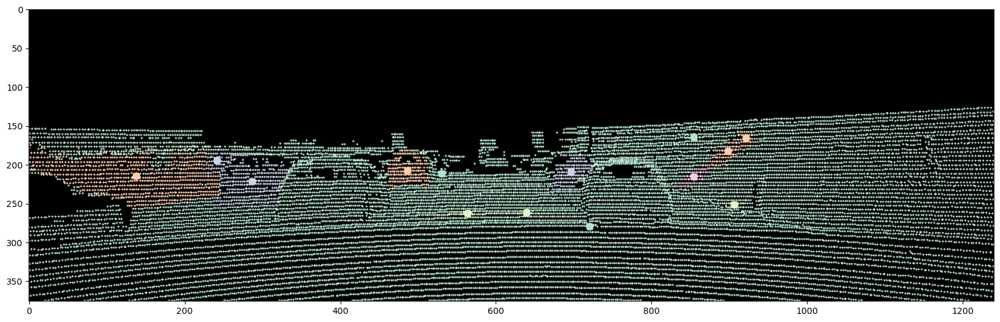

In [310]:
new_image = np.zeros_like(left_image)
new_image = draw_clusters_on_image(new_image, cam_clusters, draw_centroids=True)
plt.imshow(new_image)
plt.savefig('./output/cluster.png')

In [311]:
from sklearn.cluster import DBSCAN

def get_clusters(velo_points):
    dbscan = DBSCAN(eps=0.55, min_samples=30)
    dbscan.fit(velo_points[:3, :].T)

    labels = dbscan.labels_

    return dbscan, labels

In [312]:
def get_likely_clusters(cluster_dict, object_centers, min_thresh=50, thresh=75):
    ''' Obtains more likely clusters '''

    new_clusters = {}
    noise_cluster = cluster_dict[-1]

    labels = sorted(cluster_dict)

    for label in labels:
        cluster = cluster_dict[label]

        if cluster.shape[1] > min_thresh \
           and cluster.shape[1] < noise_cluster.shape[1] //2: 

            # ensure centroid has correct order
            centroid = np.mean(cluster, axis=1)[[1, 0, 2]]

            # check if any objects are detected
            if len(object_centers) > 0:
                delta = np.linalg.norm(centroid - object_centers, axis=1)
                min_loc = np.argmin(delta)

                if delta[min_loc] < thresh:
                    new_clusters.update({label : cluster})

            else:
                new_clusters.update({label : cluster})

    return new_clusters

In [313]:
def get_3d_bboxes(cluster_dict, labels, velo_points):
    camera_box_point_list = []

    for c_label, cluster in cluster_dict.items():

        velo_cluster = velo_points[:3, labels == c_label]

        (x_min, y_min, z_min) = velo_cluster.min(axis=1)
        (x_max, y_max, z_max) = velo_cluster.max(axis=1)

        # now get points to define 3d bounding box
        # box_points = np.array([[x_max, y_max, z_max]]) * arr
        # just manually do this for now
        box_points = np.array([
            [x_max, y_max, z_max, 1],
            [x_max, y_max, z_min, 1],
            [x_max, y_min, z_max, 1],
            [x_max, y_min, z_min, 1],
            [x_min, y_max, z_max, 1],
            [x_min, y_max, z_min, 1],
            [x_min, y_min, z_max, 1],
            [x_min, y_min, z_min, 1]
        ])

        # convert these box points to image space
        camera_box_points = T_mat @ box_points.T
        camera_box_points[:2] /= camera_box_points[2, :]

        camera_box_points = camera_box_points.round().T.astype(int)

        # append to list
        camera_box_point_list.append(camera_box_points)

    return camera_box_point_list

In [314]:
pastel = cm.get_cmap('Pastel2', lut=50)
get_pastel = lambda z : [255*val for val in pastel(z)[:3]]

def draw_3d_boxes(image, camera_box_points):
    for i, box_pts in enumerate(camera_box_points):
        [A, B, C, D, E, F, G, H] = box_pts[:, :2]
        color = get_pastel(i)

        # draw rear box (X-axis is forward for LiDAR)
        cv2.line(image, A, B, color, 2)
        cv2.line(image, B, D, color, 2)
        cv2.line(image, A, C, color, 2)
        cv2.line(image, D, C, color, 2)
        
        # draw front box
        cv2.line(image, G, E, color, 2)
        cv2.line(image, H, F, color, 2)
        cv2.line(image, G, H, color, 2)
        cv2.line(image, E, F, color, 2)

        # draw sides
        cv2.line(image, E, A, color, 2)
        cv2.line(image, G, C, color, 2)
        cv2.line(image, F, B, color, 2)
        cv2.line(image, H, D, color, 2)

    return image

/tmp/ipykernel_1310036/591293878.py:1: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  pastel = cm.get_cmap('Pastel2', lut=50)


In [315]:
velo_points = bin2h_velo(lidar_bin, remove_plane=True) # possibly RANSAC the walls too


In [316]:
def main_pipeline(left_image, lidar_bin, velo_points):
    # get object detections
    left_image, bboxes_out, velo_camera = get_depth_detections(left_image, 
                                                           lidar_bin, 
                                                           draw_boxes=False, 
                                                           draw_depth=False)
    
    # perform clustering in LiDAR space
    dbscan, labels = get_clusters(velo_points)


    # get clusters in image space
    cam_clusters = image_clusters_from_velo(velo_points, labels, left_image)

    # get object centers in camera (u, v, z) coordinates
    object_centers = bboxes_out[:, 6:]

    # remove small and large clusters also remove cluster far away from detected objects
    cam_clusters = get_likely_clusters(cam_clusters, object_centers, min_thresh=25, thresh=70)

    # get 3D bbox points in camera space from clusters
    camera_box_points = get_3d_bboxes(cam_clusters, labels, velo_points)


    
    # draw 3D bounding boxes on the image
    left_image = draw_3d_boxes(left_image, camera_box_points)

    return left_image, cam_clusters




0: 224x640 6 cars, 94.0ms
Speed: 3.6ms preprocess, 94.0ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 640)


/tmp/ipykernel_1310036/2985351262.py:3: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  pastel = cm.get_cmap('Pastel2', lut=50)


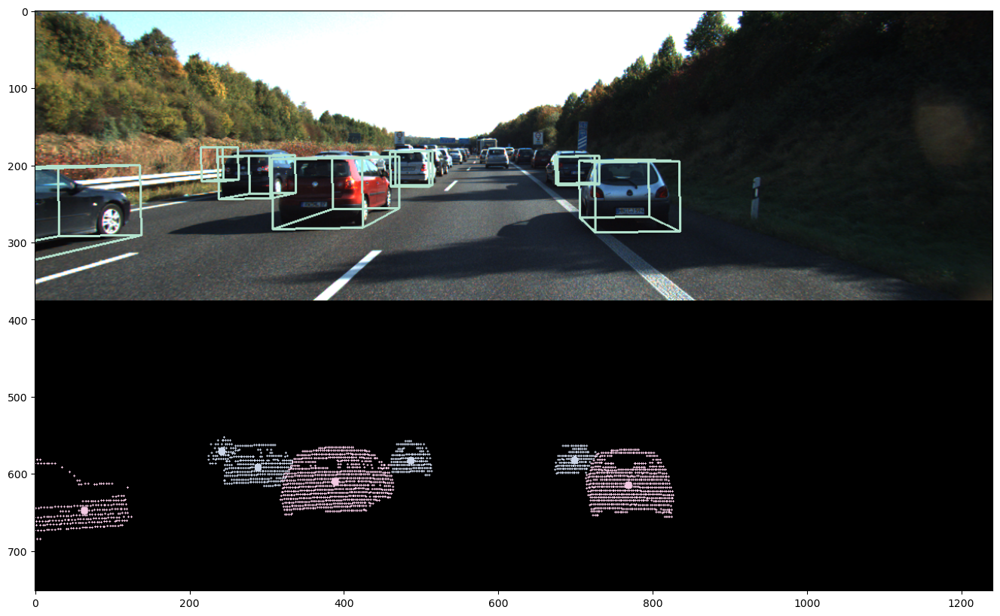

In [317]:
# run pipeline
left_image, cam_clusters = main_pipeline(left_image_copy, lidar_bin, velo_points)

# draw projected clusters on new image
cluster_image = np.zeros_like(left_image)
cluster_image = draw_clusters_on_image(cluster_image, cam_clusters, draw_centroids=True)

stacked = np.vstack((left_image, cluster_image))

plt.imshow(stacked)
plt.savefig('./output/3d_box.png')

In [318]:
get_total_seconds = lambda hms: hms[0]*60*60 + hms[1]*60 + hms[2]


def timestamps2seconds(timestamp_path):
    ''' Reads in timestamp path and returns total seconds (does not account for day rollover '''
    timestamps = pd.read_csv(timestamp_path, 
                             header=None) \
                             .squeeze(axis=1).astype(object) \
                                          .apply(lambda x: x.split(' ')[1]) 
    
    # Get Hours, Minutes, and Seconds
    hours = timestamps.apply(lambda x: x.split(':')[0]).astype(np.float64)
    minutes = timestamps.apply(lambda x: x.split(':')[1]).astype(np.float64)
    seconds = timestamps.apply(lambda x: x.split(':')[2]).astype(np.float64)

    hms_vals = np.vstack((hours, minutes, seconds)).T
    
    total_seconds = np.array(list(map(get_total_seconds, hms_vals)))
    
    return total_seconds


In [319]:
cam2_total_seconds = timestamps2seconds(os.path.join(DATA_PATH, r'image_02/timestamps.txt'))

In [320]:
# camera 2 frames per second
cam2_fps = 1/np.median(np.diff(cam2_total_seconds))
cam2_fps

9.650876083495664


0: 224x640 6 cars, 25.1ms
Speed: 1.0ms preprocess, 25.1ms inference, 0.8ms postprocess per image at shape (1, 3, 224, 640)


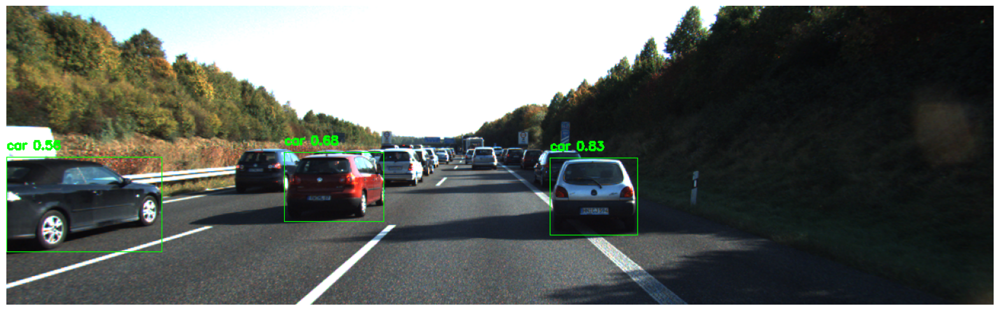


0: 224x640 6 cars, 20.7ms
Speed: 1.0ms preprocess, 20.7ms inference, 0.6ms postprocess per image at shape (1, 3, 224, 640)


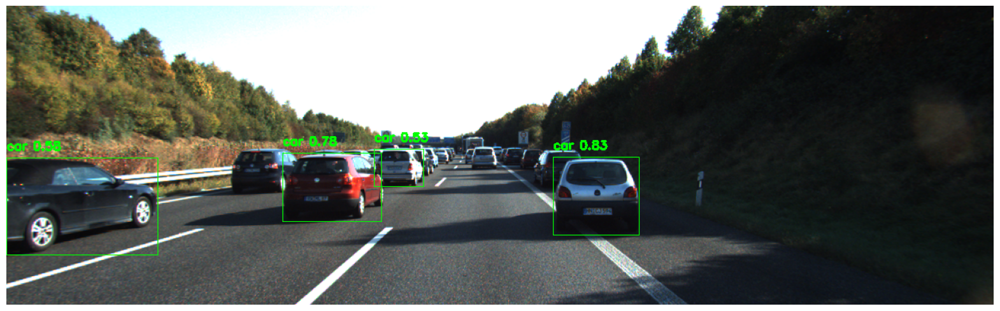


0: 224x640 7 cars, 22.8ms
Speed: 0.9ms preprocess, 22.8ms inference, 0.5ms postprocess per image at shape (1, 3, 224, 640)


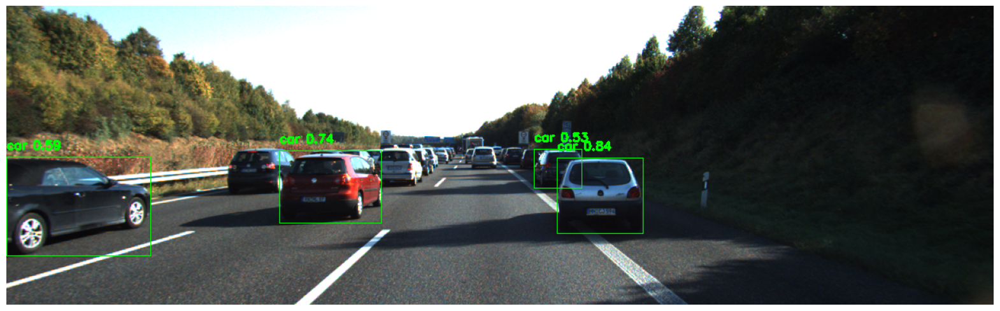


0: 224x640 7 cars, 22.5ms
Speed: 0.8ms preprocess, 22.5ms inference, 0.5ms postprocess per image at shape (1, 3, 224, 640)


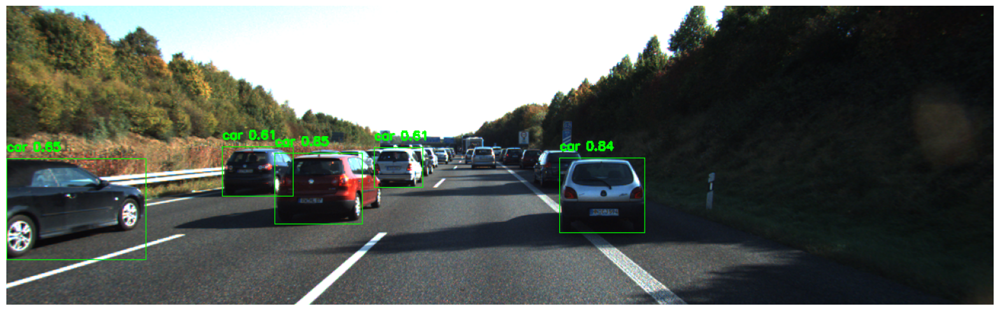


0: 224x640 7 cars, 24.1ms
Speed: 0.9ms preprocess, 24.1ms inference, 0.5ms postprocess per image at shape (1, 3, 224, 640)


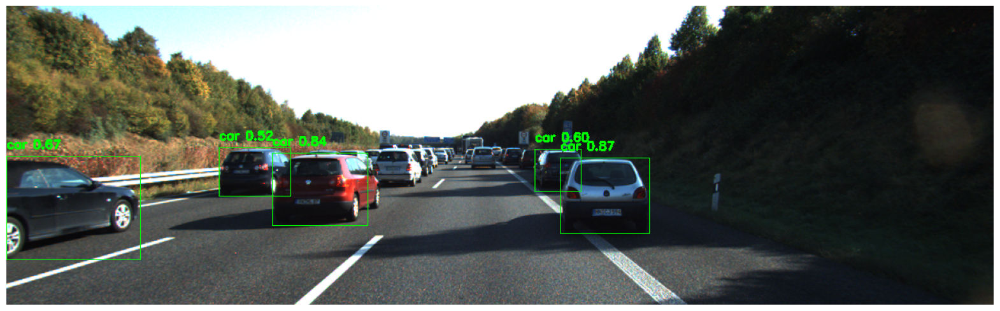


0: 224x640 7 cars, 22.8ms
Speed: 1.1ms preprocess, 22.8ms inference, 0.6ms postprocess per image at shape (1, 3, 224, 640)


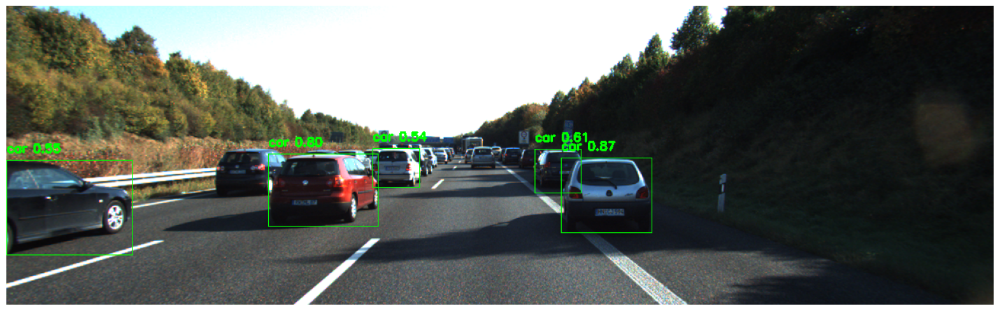


0: 224x640 6 cars, 28.5ms
Speed: 1.0ms preprocess, 28.5ms inference, 0.8ms postprocess per image at shape (1, 3, 224, 640)


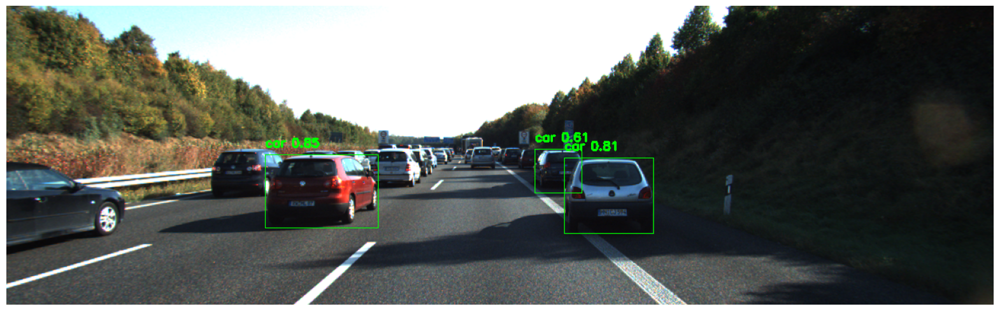


0: 224x640 6 cars, 20.8ms
Speed: 0.9ms preprocess, 20.8ms inference, 0.5ms postprocess per image at shape (1, 3, 224, 640)


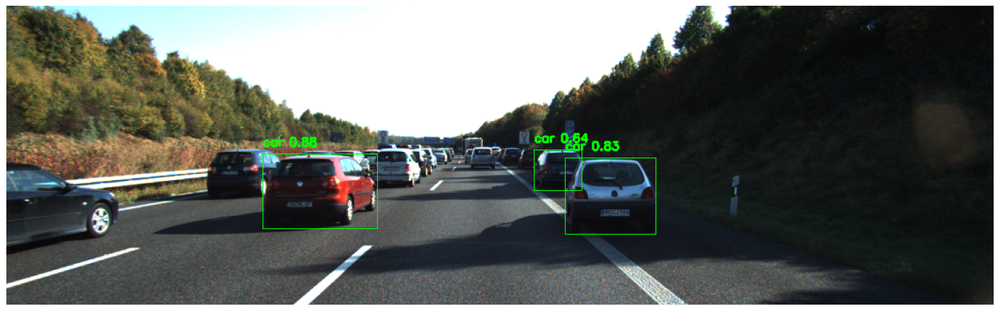


0: 224x640 5 cars, 23.1ms
Speed: 0.9ms preprocess, 23.1ms inference, 0.5ms postprocess per image at shape (1, 3, 224, 640)


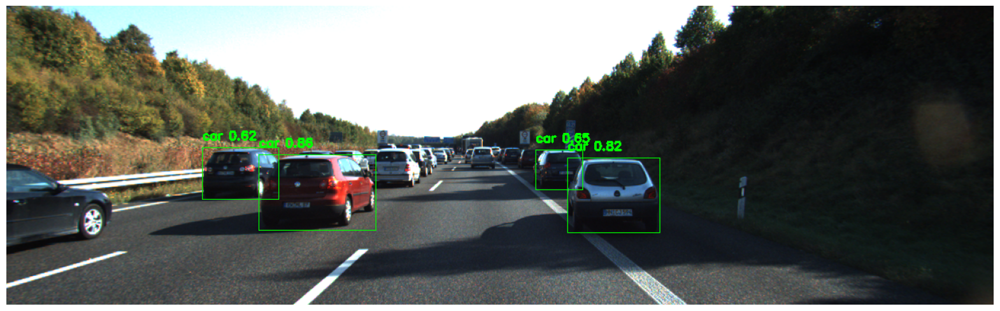

In [321]:
result_video = []

for index in range(len(left_image_paths)-1):
    left_image = cv2.cvtColor(cv2.imread(left_image_paths[index]), cv2.COLOR_BGR2RGB)
    bin_path = bin_paths[index]
    oxts_frame = get_oxts(oxts_paths[index])

    # get detections and object centers in uvz
    bboxes, velo_uvz = get_detection_coordinates(left_image, bin_path)

    # get transformed coordinates
    uvz = bboxes[:, -3:]

    # velo_xyz = transform_uvz(uvz, T_cam2_velo) # we can also get LiDAR coordiantes
    imu_xyz = transform_uvz(uvz, T_cam2_imu)

    # draw velo on blank image
    velo_image = draw_velo_on_image(velo_uvz, np.zeros_like(left_image))

    # stack frames
    stacked = np.vstack((left_image, velo_image))

    # draw top down scenario on canvas
    canvas = np.zeros((canvas_height, canvas_width, 3), dtype=np.uint8)
    draw_scenario(canvas, imu_xyz, sf=12)
    
    # place everything in a single frame
    frame = np.hstack((stacked, 
                       255*np.ones((canvas_height, 1, 3), dtype=np.uint8),
                       canvas))

    # add to result video
    result_video.append(frame)



In [322]:
# get width and height for video frames
h, w, _ = frame.shape

In [323]:
out = cv2.VideoWriter('./output/out2.avi',
                      cv2.VideoWriter_fourcc(*'DIVX'), 
                      cam2_fps, 
                      (w,h))
 
for i in range(len(result_video)):
    out.write(cv2.cvtColor(result_video[i], cv2.COLOR_BGR2RGB))
out.release()